## Library Imports

In this section, we import all the necessary libraries required for image processing, visualization, and logging. The key libraries used in this project include:

- **os**: For interacting with the operating system and file paths.
- **random**: To randomly select images for visualization.
- **PIL (Python Imaging Library)**: For opening and manipulating image files.
- **matplotlib**: For visualizing images and data.
- **torch.utils.tensorboard**: To log images and data for visualization in TensorBoard.
- **torchvision.transforms**: For converting images to tensors and applying transformations.

These libraries provide the foundational tools for loading, displaying, and logging image data throughout the project.

In [6]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
from torchvision import transforms

### `display_image` Function

The `display_image` function visualizes a specified number of randomly selected images from a given folder. It is useful for quickly inspecting the contents of an image dataset.

**Parameters:**
- `path_to_img_folder` (str): Path to the folder containing image files.
- `num_images` (int): Number of images to display.

**Functionality:**
- Lists all image files in the specified folder.
- Randomly selects the requested number of images (or fewer if not enough images are available).
- Displays the selected images in a single row using Matplotlib, with each image labeled by its filename.

This function helps in visually verifying the dataset and ensuring that images are loaded correctly.

In [7]:
def display_image(path_to_img_folder, num_images):
    # Get all image file names in the folder
    image_names = os.listdir(path_to_img_folder)
    
    # Ensure num_images is not larger than the number of available images
    num_images = min(num_images, len(image_names))
    
    # Randomly select the required number of images
    selected_images = random.sample(image_names, num_images)
    
    # Set up the plot
    fig, axes = plt.subplots(1, num_images, figsize=(num_images*6, 6))
    
    # Plot each image
    for ax, image_name in zip(axes, selected_images):
        image_path = os.path.join(path_to_img_folder, image_name)
        img = Image.open(image_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(image_name, fontsize=50)
    
    plt.tight_layout()
    plt.show()

### `display_data` Function

The `display_data` function iterates through each label (subfolder) in the specified dataset directory and displays a set number of sample images for each label using the `display_image` function.

**Parameters:**
- `path_to_data` (str): Path to the main dataset directory, where each subfolder represents a label.
- `samples_per_label` (int, default=10): Number of images to display per label.

**Functionality:**
- Lists all label subfolders in the dataset directory.
- For each label, prints the label name and displays the specified number of sample images from that label's folder.
- Utilizes the `display_image` function for visualization.

This function provides a quick overview of the dataset distribution and sample images for each class, aiding in data inspection and verification.

In [8]:
def display_data(path_to_data, samples_per_label=10):
    labels = os.listdir(path_to_data)
    for label in labels:
        print(f"Label: {label}")
        label_path = os.path.join(path_to_data, label)
        if os.path.isdir(label_path):
            display_image(label_path, num_images=samples_per_label)

### `add_images_to_tensorboard` Function

The `add_images_to_tensorboard` function logs a specified number of sample images per label from a dataset directory to TensorBoard for visualization.

**Parameters:**
- `path_to_data` (str): Path to the main dataset directory, where each subfolder represents a label.
- `samples_per_label` (int, default=10): Number of images to log per label.
- `color_mode` (str, default='RGB'): Color mode for images; either `'RGB'` for color images or `'L'` for grayscale.

**Functionality:**
- Iterates through each label (subfolder) in the dataset directory.
- For each label, randomly selects the specified number of images.
- Converts each image to the chosen color mode and transforms it into a tensor.
- Logs each image to TensorBoard under its corresponding label and filename.
- Supports both RGB and grayscale image logging for flexible visualization.

This function is useful for visually inspecting dataset samples directly in TensorBoard, aiding in data exploration and debugging.

In [9]:
def add_images_to_tensorboard(path_to_data, samples_per_label=10, color_mode='RGB'):
    labels = os.listdir(path_to_data)
    writer = SummaryWriter(log_dir=f"/Users/arponbiswas/Computer-Vision-Projects/Image_classification_projects/PC_Parts_Image_Classification/Tensorboard_Graph/Data_Graph/{color_mode}_images")
    print(f"Adding images to TensorBoard in {color_mode} mode...")
    if color_mode not in ['RGB', 'L']:
        raise ValueError("color_mode must be either 'RGB' or 'L' (grayscale)")
    else:
        for label in labels:
            print(f"Adding images for label: {label}")
            label_path = os.path.join(path_to_data, label)
            if os.path.isdir(label_path):
                image_names = os.listdir(label_path)
                selected_images = random.sample(image_names, min(samples_per_label, len(image_names)))
                for image_name in selected_images:
                    image_path = os.path.join(label_path, image_name)
                    img = Image.open(image_path).convert(color_mode)
                    img_tensor = transforms.ToTensor()(img)
                    writer.add_image(f"{label}/{image_name}", img_tensor, 0)
            print(f"Added images for label: {label} ✅")
    writer.flush()
    writer.close()

### Visualizing and Logging Dataset Samples

In this section, we display sample images from each label in the dataset and log them to TensorBoard for further inspection. This helps verify the dataset's structure and provides a visual overview of the data distribution across different classes. Both RGB and grayscale versions of the images are logged to facilitate comprehensive analysis and debugging.

Label: headset


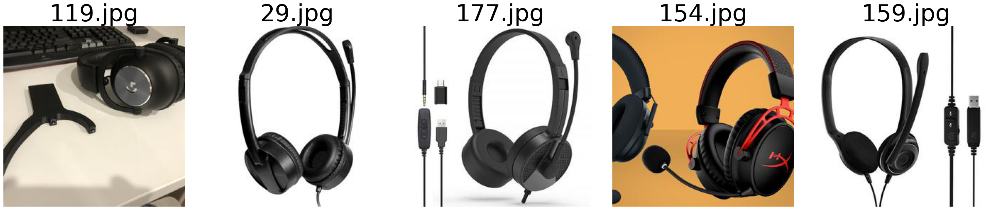

Label: motherboard


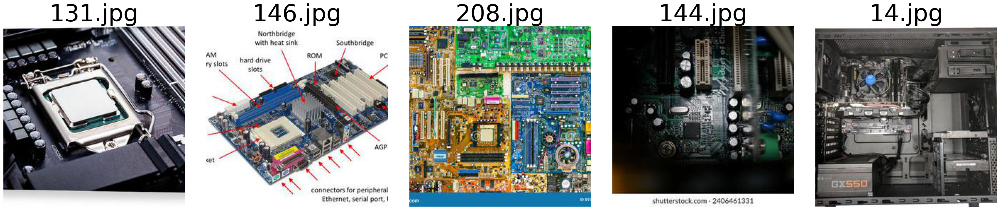

Label: monitor


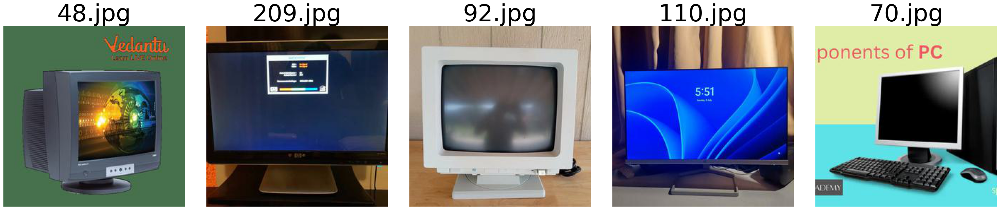

Label: gpu


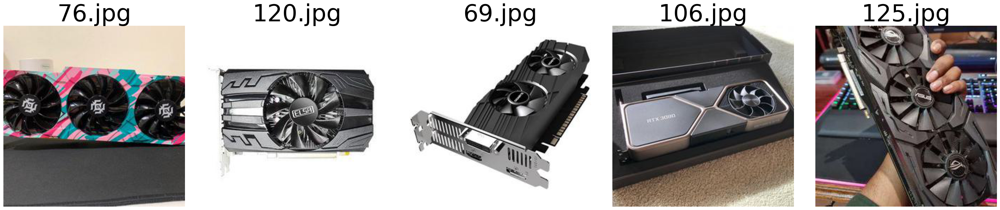

Label: microphone


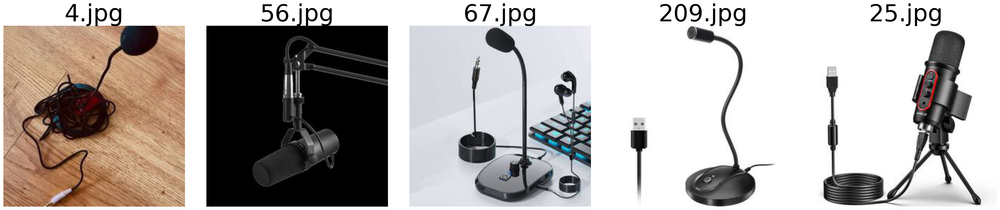

Label: speakers


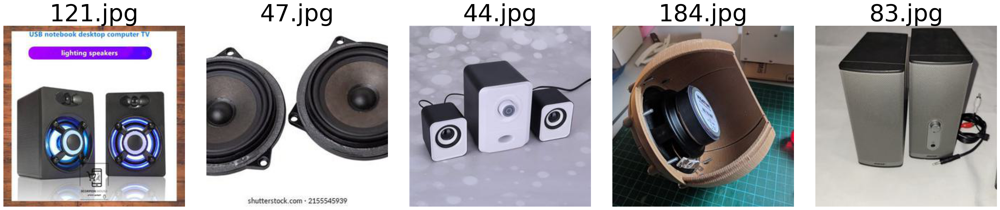

Label: cpu


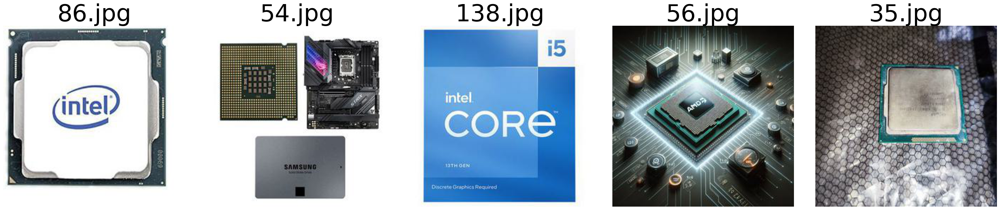

Label: mouse


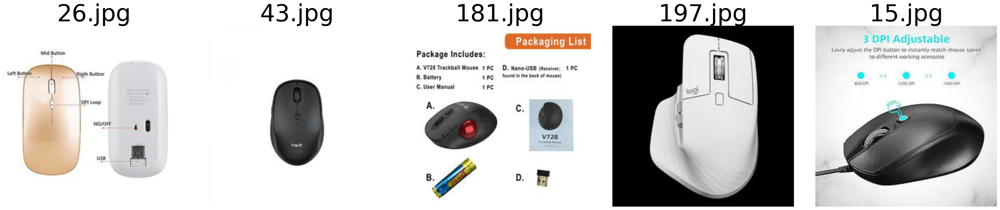

Label: case


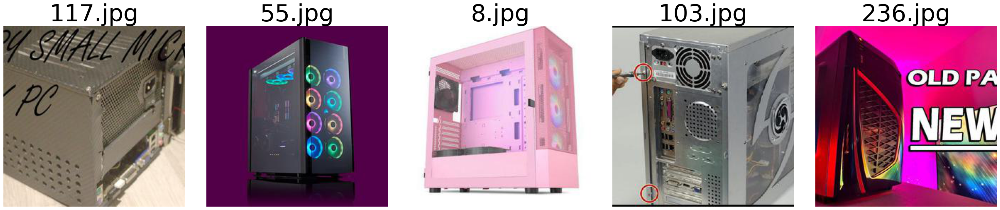

Label: cables


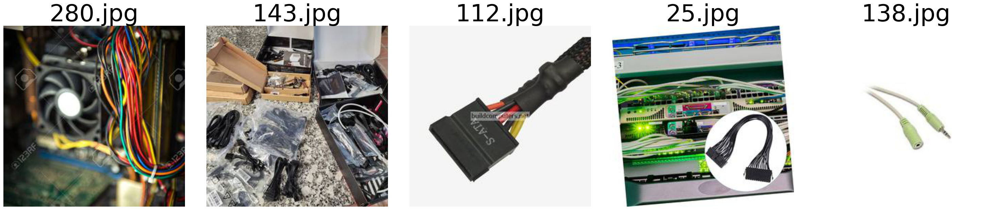

Label: hdd


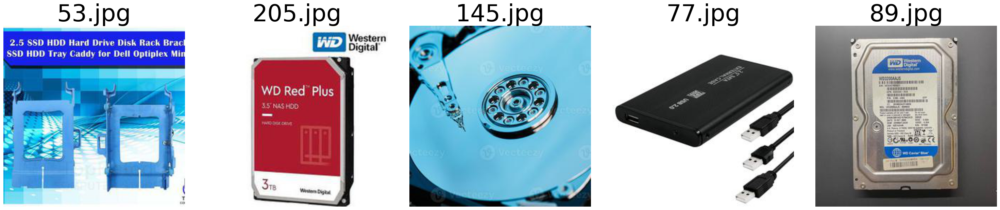

Label: webcam


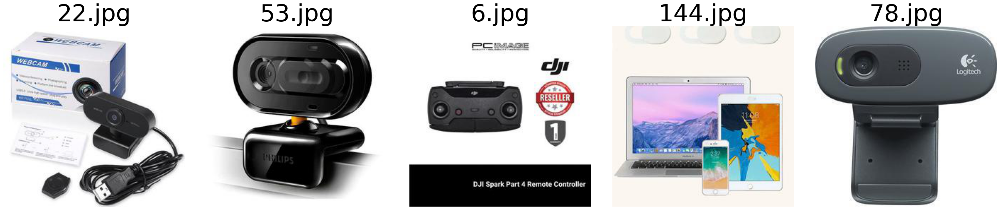

Label: keyboard


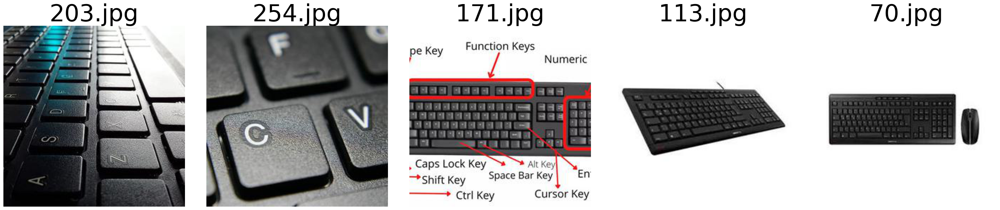

Label: ram


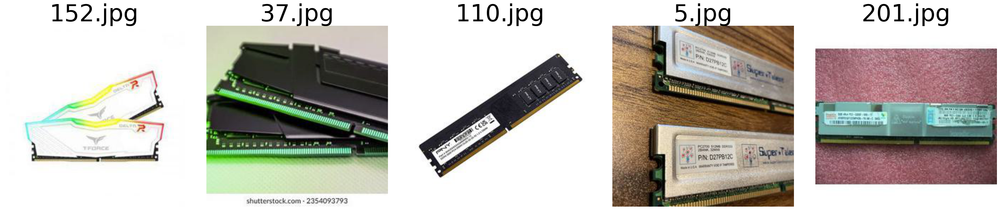

Adding images to TensorBoard in RGB mode...
Adding images for label: headset
Added images for label: headset ✅
Adding images for label: motherboard
Added images for label: motherboard ✅
Adding images for label: monitor
Added images for label: monitor ✅
Adding images for label: gpu
Added images for label: gpu ✅
Adding images for label: microphone
Added images for label: microphone ✅
Adding images for label: speakers
Added images for label: speakers ✅
Adding images for label: cpu
Added images for label: cpu ✅
Adding images for label: mouse
Added images for label: mouse ✅
Adding images for label: case
Added images for label: case ✅
Adding images for label: cables
Added images for label: cables ✅
Adding images for label: hdd
Added images for label: hdd ✅
Adding images for label: webcam
Added images for label: webcam ✅
Adding images for label: keyboard
Added images for label: keyboard ✅
Adding images for label: ram
Added images for label: ram ✅
Adding images to TensorBoard in L mode...
Addi

In [10]:
display_data(path_to_data='/Users/arponbiswas/Computer-Vision-Projects/Image_classification_projects/PC_Parts_Image_Classification/Data/pc_parts_ready', samples_per_label=5)

# For RGB images
add_images_to_tensorboard(path_to_data='/Users/arponbiswas/Computer-Vision-Projects/Image_classification_projects/PC_Parts_Image_Classification/Data/pc_parts_ready', samples_per_label=20, color_mode='RGB')

# For Grayscale images
add_images_to_tensorboard(path_to_data='/Users/arponbiswas/Computer-Vision-Projects/Image_classification_projects/PC_Parts_Image_Classification/Data/pc_parts_ready', samples_per_label=20, color_mode='L')